The goal here is to demonstrate that we can locate validation events from their correlations. 

For each validation event in the Wells region, we load the relevant signal window at NV01. We initialize an SG with GP signal models and with the event in the true location. We propose alignments for each phase using the smart correlation alignment proposal. Then we
- plot the true and predicted signals, to understand how good the GP predictions are
- also plot the true signal with alignments from the closest neighbor among the training events, as a baseline
- plot the probability surface for the event location within the Wells region, based on the GP probability of the extracted wavelet coefs. 

In [1]:
import numpy as np
from sigvisa import Sigvisa

from sigvisa.infer.coarse_to_fine_init import ModelSpec, EventRunSpec, TimeRangeRunSpec, do_coarse_to_fine, initialize_from, do_inference, initialize_sg
from sigvisa.graph.sigvisa_graph import SigvisaGraph
from sigvisa.treegp.gp import GPCov
from sigvisa.graph.region import Region
from sigvisa.source.event import get_event

import cPickle as pickle

from sigvisa.utils.geog import dist_km

%matplotlib inline
import matplotlib.pylab as plt

from sigvisa.signals.common import Waveform

from sigvisa.explore.correlate_validation_events import load_arrivals
from sigvisa.explore.correlate_validation_events_align import build_sg, proposal_xc, locate_event, get_prior_nm

from sigvisa.infer.correlations.weighted_event_posterior import hack_ev_time_posterior_with_weight, compute_atime_posteriors
from sigvisa.infer.correlations.historical_signal_library import get_historical_signals
from sigvisa.infer.correlations.event_proposal import compute_proposal_distribution

In [2]:
# build a timespec SG with the first hour of Wells validation data

def build_sg(stas, evid):

    runid = 17
    hz=10.0
    uatemplate_rate=4e-4
    bands=["freq_0.8_4.5"]
    phases=["Pn", "Sn", "Lg", "Pg"]
    hack_constraint = True
    raw_signals = True

    region_lon = (-126, -100)
    region_lat = (32, 49)

    runids=(runid,)

    rs = EventRunSpec(stas=stas, evids=[evid,])

    ev = get_event(evid)
    region_stime = ev.time - 150
    region_etime = ev.time + 200
    region = Region(lons=region_lon, lats=region_lat,
                    times=(region_stime, region_etime),
                    rate_bulletin="isc",
                    min_mb=2.0,
                    rate_train_start=1167609600,
                    rate_train_end=1199145600)


    ms1 = ModelSpec(template_model_type="gpparam",
                    wiggle_family="db4_2.0_3_20.0",
                    wiggle_model_type="gplocal+lld+none",
                    uatemplate_rate=uatemplate_rate,
                    max_hz=hz,
                    phases=phases,
                    bands=bands,
                    runids=runids,
                    inference_region=region,
                    dummy_fallback=False,
                    raw_signals=raw_signals,
                    hack_param_constraint=hack_constraint,
                    vert_only=True)

    sg = rs.build_sg(ms1)
    return sg

In [42]:
from sigvisa.models.distributions import Gaussian
from sigvisa.plotting.event_heatmap import EventHeatmap

def extract_wavelet_posterior(wn, eid, phase):
    # extract phase signal for neighbor wn
    d = wn.get_value().data
    ell, marginals, step_ells = wn.tssm.all_filtered_cssm_coef_marginals(d)
    for i, (eid, pphase, scale, sidx, npts, component_type) in enumerate(wn.tssm_components):
        if component_type != "wavelet": continue
        if pphase!=phase: continue
        wmeans, wvars = marginals[i]
        break
    return wmeans, wvars

def build_heatmap(wn, ev, phase, **kwargs):
    wmeans, wvars = extract_wavelet_posterior(wn, 1, phase)

    def loc_logp(lon, lat):
        evdict = {"lon": lon, "lat": lat, "depth": ev.depth, "time": ev.time, "mb": ev.mb}
        prior_means = np.array([gp.predict(cond=evdict) for gp in wn.wavelet_param_models[phase]], dtype=np.float)
        prior_vars = np.array([gp.variance(cond=evdict, include_obs=True) for gp in wn.wavelet_param_models[phase]], dtype=np.float)
        dists = [Gaussian(mean, std=np.sqrt(var)) for (mean, var) in zip(prior_means, prior_vars)]
        lps = [d.log_p(w) for (d, w) in zip(dists, wmeans)]
        return np.sum(lps)
    

    hm = EventHeatmap(f=loc_logp, **kwargs)
    training_X = wn.wavelet_param_models[phase][0].X
    hm.add_events(training_X)
    hm.set_true_event(ev.lon, ev.lat)
    return hm


evid 1051117.0, loc 114.93 W 41.17 N, depth 8.9km, time 1203627412.3, mb 2.6, natural source
evid 1051129.0, loc 114.93 W 41.16 N, depth 4.6km, time 1203629750.1, mb 2.9, natural source
evid 1051196.0, loc 114.91 W 41.19 N, depth 6.3km, time 1203638571.1, mb 2.8, natural source
evid 1051201.0, loc 114.79 W 41.27 N, depth 12.9km, time 1203639237.1, mb 2.7, natural source
evid 1051205.0, loc 114.93 W 41.14 N, depth 8.5km, time 1203639298.8, mb 2.8, natural source
proposal using correlation True
proposal using correlation True
proposal using correlation True
proposal using correlation True
reading station detections... 
proposal using correlation True
proposal using correlation True
proposal using correlation True
proposal using correlation True
reading station detections... 
proposal using correlation True
proposal using correlation True
proposal using correlation True
proposal using correlation True
reading station detections... 
proposal using correlation True
proposal using correlatio

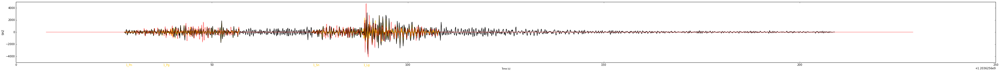

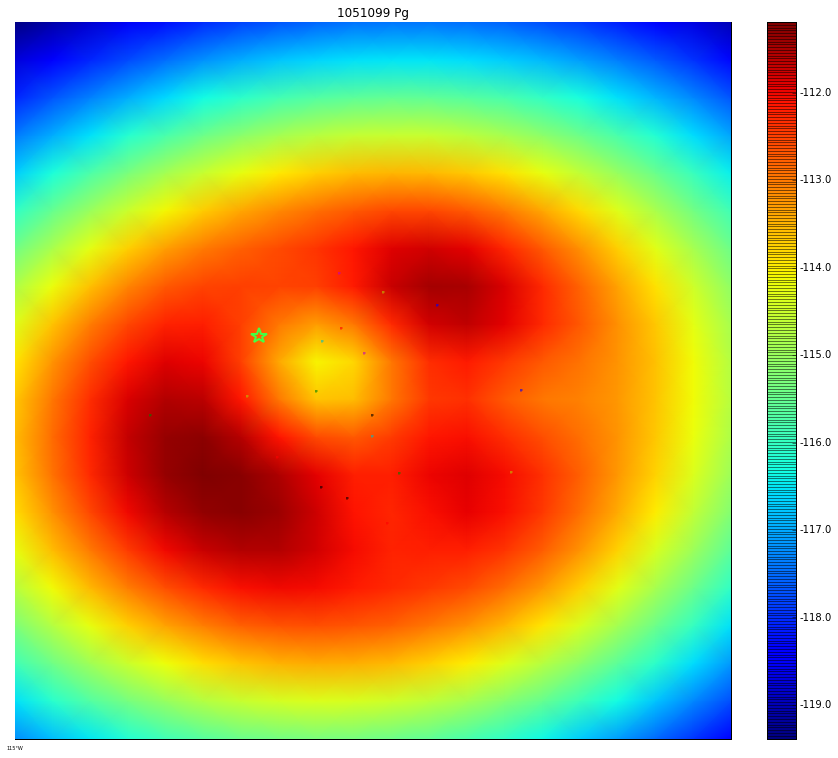

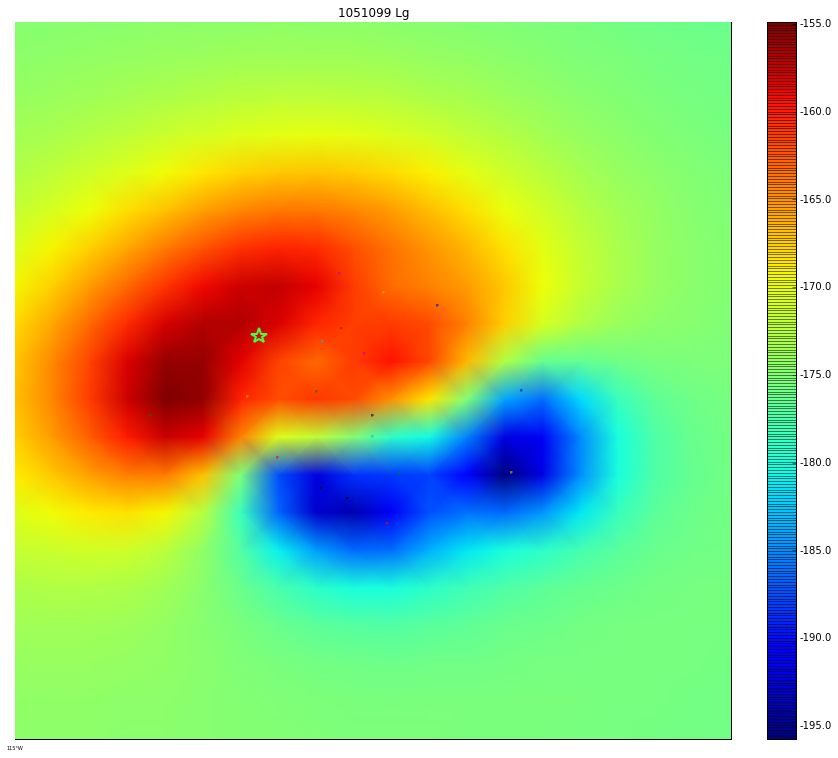

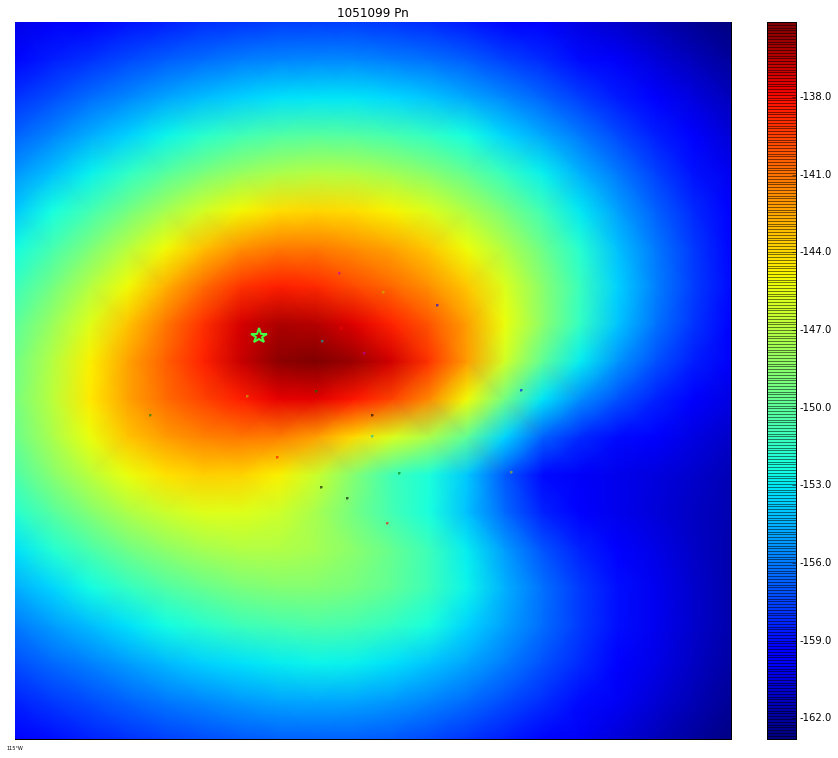

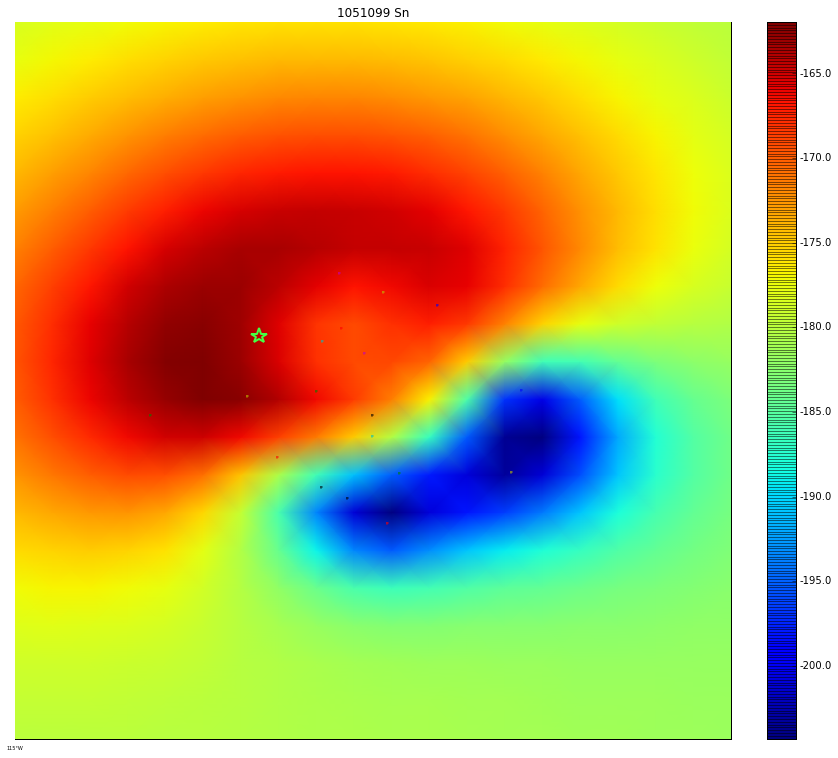

...

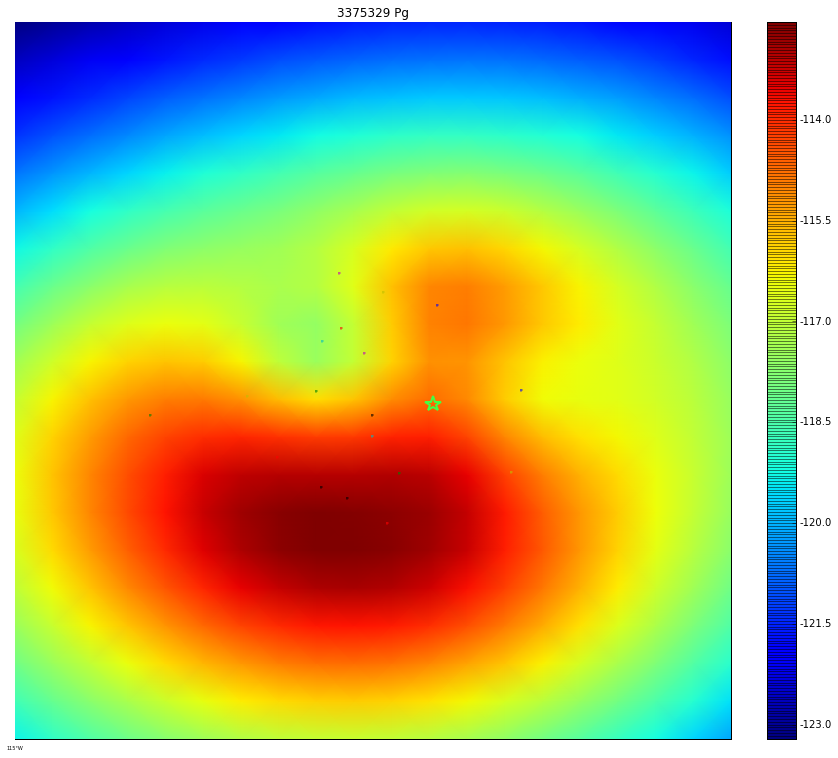

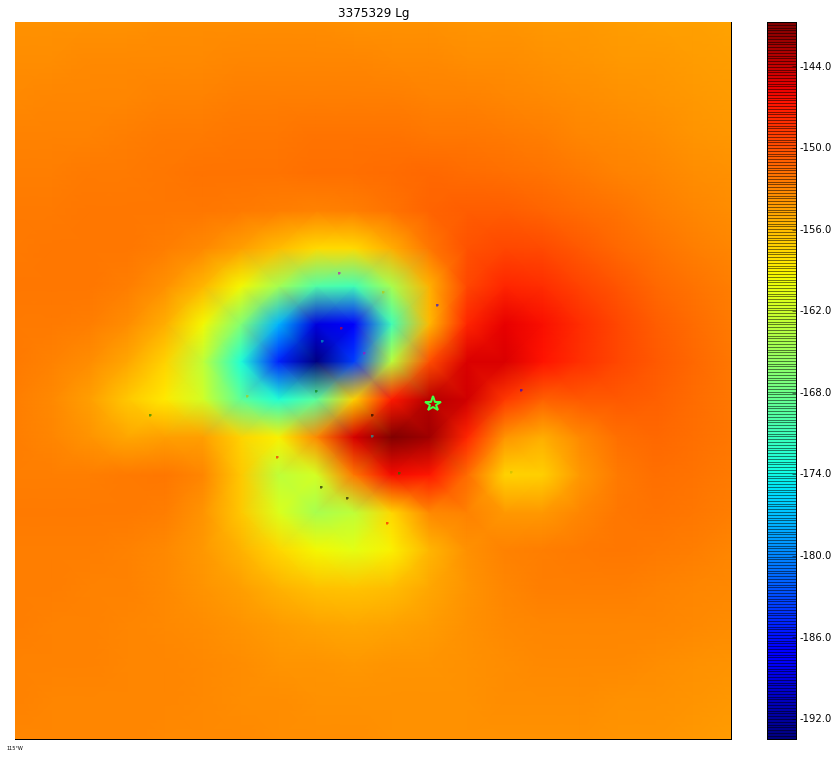

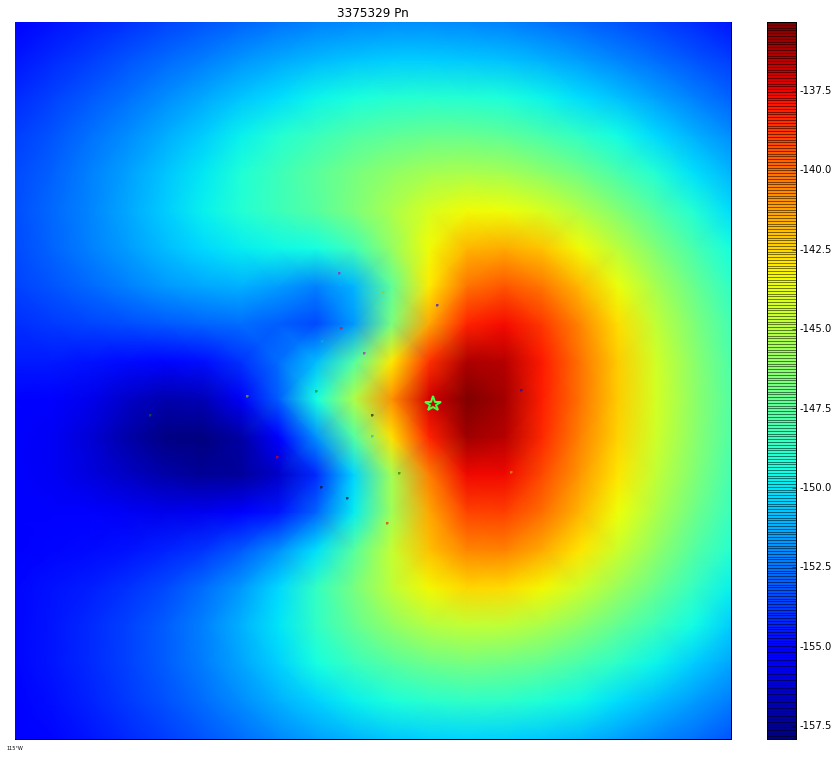

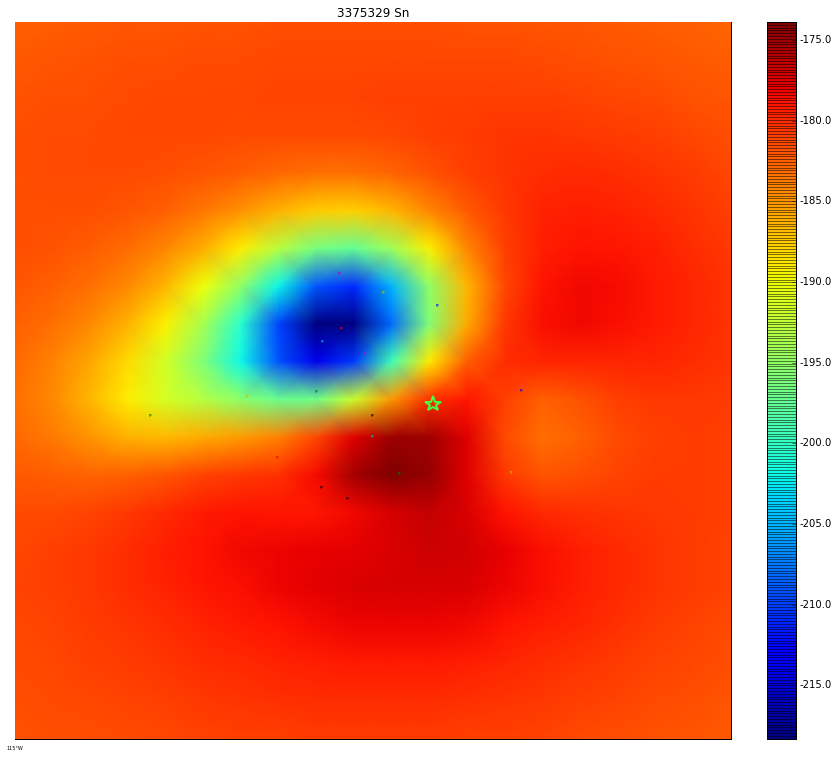

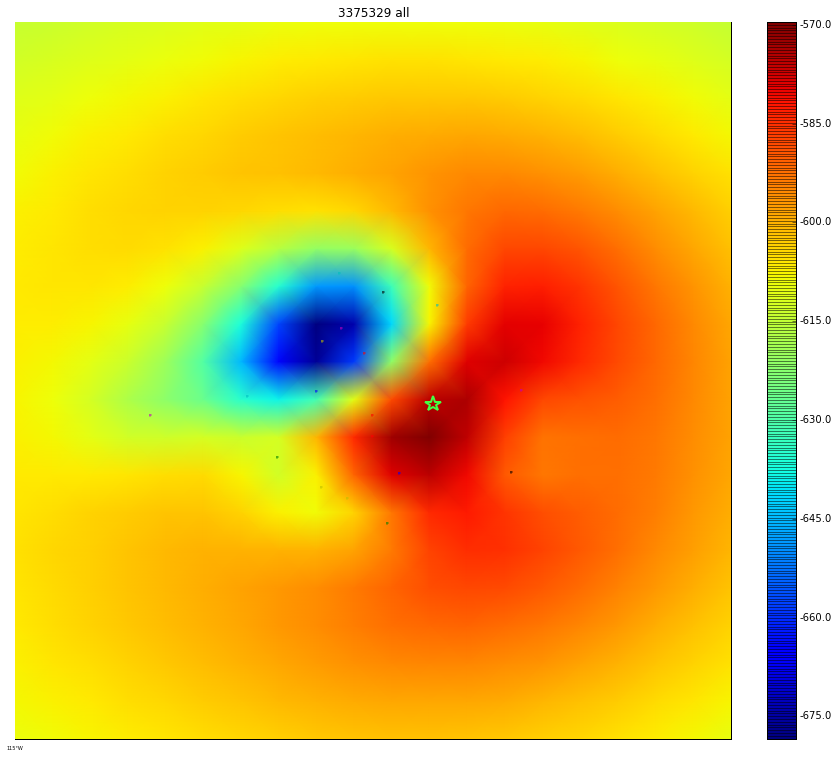

In [43]:
from sigvisa.infer.event_birthdeath import ev_template_birth_helper

train_evids = np.loadtxt("/home/dmoore/python/sigvisa/train_clusters/cluster_017")
validation_evids = np.loadtxt("/home/dmoore/python/sigvisa/notebooks/thesis/validation_evids.txt")

s = Sigvisa()

wells_validation = []
for evid in validation_evids:
    ev = get_event(evid=evid)
    if -115.5 < ev.lon < -114 and 40.5 < ev.lat < 41.8:
        #print ev
        wells_validation.append(evid)

non_leb_validation = []
for evid in wells_validation:
    ev = get_event(evid=evid)
    query = "select evid from leb_origin where lon between %f and %f and lat between %f and %f and time between %f and %f" % (ev.lon-.3, ev.lon+.3, ev.lat-.3, ev.lat+.3, ev.time-50, ev.time + 50)
    r = s.sql(query)
    if len(r) == 0:
        non_leb_validation.append(evid)
        print ev

    
#stas = "ANMO,ELK,ILAR,KDAK,NEW,NVAR,PDAR,PFO,TXAR,ULM,YBH,YKA".split(",")
stas = ["NVAR",]
phases=["Pn", "Sn", "Lg", "Pg"]
for evid in wells_validation:



    try:
        sg = build_sg(stas, evid=evid)
        ev = get_event(evid)
        sg.add_event(ev, phases=None)
        wn = sg.station_waves["NV01"][0]
    except:
        continue

    lqf, replicate_tmpls, birth_records = \
            ev_template_birth_helper(sg, 1,
                                     associate_using_mb=True,
                                     use_correlation=True,
                                     proposal_type="smart")
    f = plt.figure(figsize=(64, 4))
    ax = f.add_subplot(111)
    wn.plot(ax=ax, plot_pred=True, model_lw=0)
    
    plot_inferred_locations(wn, ev)
    

In [33]:
def is_wells_event(evid):
    ev = get_event(evid)
    return (-115.5 < ev.lon < -114 and 40.5 < ev.lat < 41.8)

train_evids = np.loadtxt("/home/dmoore/python/sigvisa/notebooks/thesis/train_evids.txt")
validation_evids = np.loadtxt("/home/dmoore/python/sigvisa/notebooks/thesis/validation_evids.txt")
test_evids = np.loadtxt("/home/dmoore/python/sigvisa/notebooks/thesis/test_evids.txt")

train_evids_wells = [evid for evid in train_evids if is_wells_event(evid)]
validation_evids_wells = [evid for evid in validation_evids if is_wells_event(evid)]
test_evids_wells = [evid for evid in test_evids if is_wells_event(evid)]

In [34]:
def evid_to_X(evid):
    ev = get_event(evid)
    return (ev.lon, ev.lat)

train_X_wells = np.array([evid_to_X(evid) for evid in train_evids_wells])
validation_X_wells = np.array([evid_to_X(evid) for evid in validation_evids_wells])
test_X_wells = np.array([evid_to_X(evid) for evid in test_evids_wells])

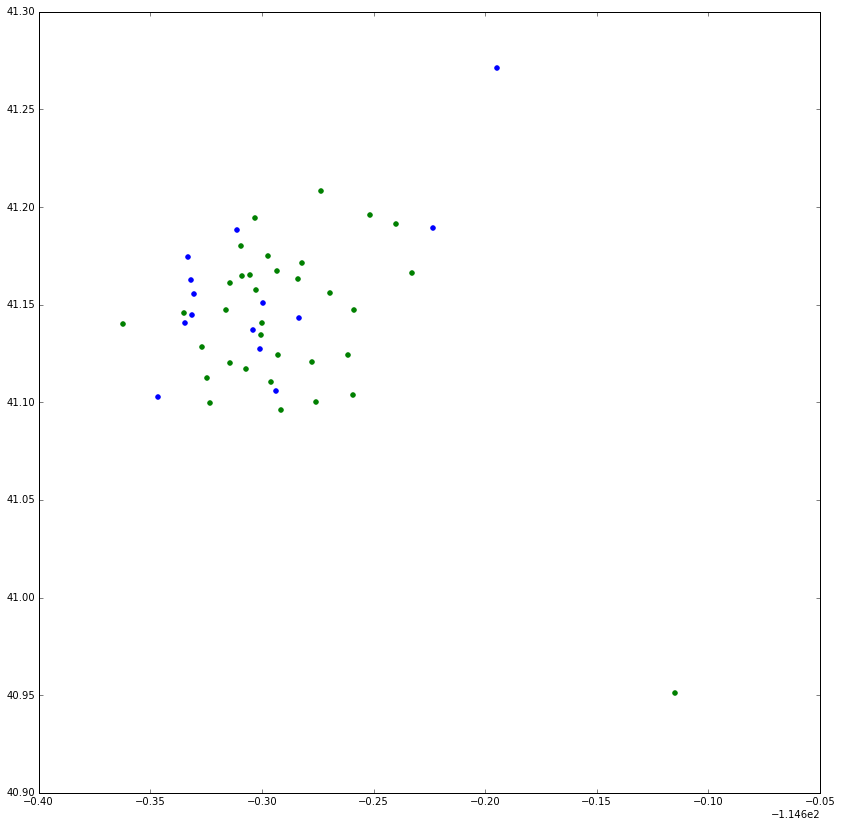

In [37]:
f = plt.figure(figsize=(14, 14))
ax=f.add_subplot(111)
ax.scatter(train_X_wells[:, 0], train_X_wells[:, 1], color="green")
ax.scatter(validation_X_wells[:, 0], validation_X_wells[:, 1], color="blue")
#ax.scatter(test_X_wells[:, 0], test_X_wells[:, 1], color="red")


In [40]:
print len(train_evids_wells)
cluster_evids = np.loadtxt("/home/dmoore/python/sigvisa/train_clusters/cluster_017")
print len(cluster_evids)

34
47


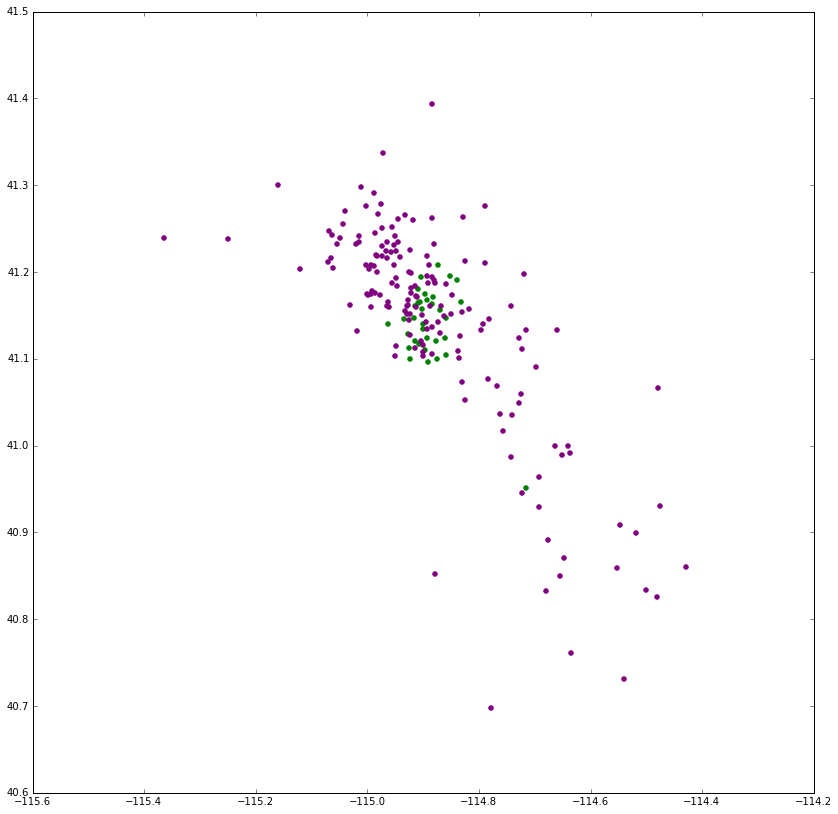

In [41]:
s = Sigvisa()
leb_query = "select lon, lat from leb_origin where lon between -115.5 and -114 and lat between 40.5 and 41.5"
leb_X = np.array(s.sql(leb_query))
f = plt.figure(figsize=(14, 14))
ax=f.add_subplot(111)
ax.scatter(train_X_wells[:, 0], train_X_wells[:, 1], color="green")
ax.scatter(leb_X[:, 0], leb_X[:, 1], color="purple")